In [1]:
%load_ext autoreload
%autoreload 2

import sys
import os
import time

import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

sys.path.append(os.path.join(os.environ['REPO_DIR'], 'utilities'))
from utilities2015 import *
from registration_utilities import *
from annotation_utilities import *
from metadata import *
from data_manager import *

/usr/local/lib/python2.7/dist-packages/matplotlib/__init__.py:1405: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


Setting environment for AWS compute node


No vtk


In [2]:
stack_fixed = 'MD662'
stack_moving = 'atlasV4'
detector_id = 1

In [3]:
volume_fixed, structure_to_label_fixed, label_to_structure_fixed = \
DataManager.load_original_volume_all_known_structures(stack=stack_fixed, prep_id=2, detector_id=detector_id, 
                                                      sided=False, volume_type='score')

File does not exist: /shared/CSHL_volumes/MD662/MD662_down32_annotationVolume/MD662_down32_annotationVolume_nameToLabel.txt
Prior structure/index map not found. Generating a new one.


rm -rf "/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_outerContour.bp" && mkdir -p "/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes"
aws s3 cp "s3://mousebrainatlas-data/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_outerContour.bp" "/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_outerContour.bp"


File does not exist: /shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_outerContour.bp
Score volume for outerContour does not exist: [Errno 2] No such file or directory: '/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_outerContour.bp'


rm -rf "/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_sp5.bp" && mkdir -p "/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes"
aws s3 cp "s3://mousebrainatlas-data/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_sp5.bp" "/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_sp5.bp"


File does not exist: /shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_sp5.bp
Score volume for sp5 does not exist: [Errno 2] No such file or directory: '/shared/CSHL_volumes/MD662/MD662_prep2_detector1_down32_scoreVolume/score_volumes/MD662_prep2_detector1_down32_scoreVolume_sp5.bp'
Volume shape: (433, 797, 373)


In [4]:
gradient_filepath_map_f = {ind_f: \
                           DataManager.get_volume_gradient_filepath_template(\
                            stack=stack_fixed, structure=struct_f, prep_id=2, detector_id=detector_id)
                           for ind_f, struct_f in label_to_structure_fixed.iteritems()}

In [8]:
registration_settings = read_csv(REGISTRATION_SETTINGS_CSV, header=0, index_col=0)
registration_settings

,upstream_warp_id,transform_type,terminate_thresh,grad_computation_sample_number,grid_search_sample_number,std_tx_um,std_ty_um,std_tz_um,std_theta_xy_degree,surround_weight,regularization_weight
warp_id,,,,,,,,,,,
1,None,affine,0.000010,100000.0,1000.0,2000,2000,2000,30,0,NaN
2,1,rigid,0.000010,100000.0,10000.0,100,100,100,30,0,NaN
4,1,rigid,0.000001,100000.0,10000.0,100,100,100,10,0,0.000001
5,1,rigid,0.000001,100000.0,10000.0,100,100,100,30,inverse,0.000000
6,1,affine,0.000010,100000.0,10000.0,100,100,100,30,-0.5,0.000000
7,None,rigid,0.000001,100000.0,1000.0,50,50,50,10,0,NaN
8,1,rigid,0.000001,100000.0,10000.0,200,200,200,30,inverse,0.000000
9,13,rigid,0.000001,100000.0,10000.0,200,200,200,30,inverse,0.000000
10,None,rigid,0.000010,100000.0,1000.0,100,100,100,30,0,NaN


In [9]:
warp_setting = 17

In [10]:
warp_properties = registration_settings.loc[warp_setting]
print warp_properties

upstream_warp_setting = warp_properties['upstream_warp_id']
if upstream_warp_setting == 'None':
    upstream_warp_setting = None
else:
    upstream_warp_setting = int(upstream_warp_setting)
    
transform_type = warp_properties['transform_type']
terminate_thresh = warp_properties['terminate_thresh']
grad_computation_sample_number = warp_properties['grad_computation_sample_number']
grid_search_sample_number = warp_properties['grid_search_sample_number']
std_tx_um = warp_properties['std_tx_um']
std_ty_um = warp_properties['std_ty_um']
std_tz_um = warp_properties['std_tz_um']
std_tx = std_tx_um/(XY_PIXEL_DISTANCE_LOSSLESS*32)
std_ty = std_ty_um/(XY_PIXEL_DISTANCE_LOSSLESS*32)
std_tz = std_tz_um/(XY_PIXEL_DISTANCE_LOSSLESS*32)
std_theta_xy = np.deg2rad(warp_properties['std_theta_xy_degree'])

try:
    surround_weight = float(warp_properties['surround_weight'])
    include_surround = surround_weight != 0 and not np.isnan(surround_weight)
except:
    surround_weight = str(warp_properties['surround_weight'])
    include_surround = True

reg_weight = warp_properties['regularization_weight']
if np.isnan(reg_weight):
    reg_weights = np.zeros((3,))
else:
    reg_weights = np.ones((3,))*reg_weight

print
print 'std', std_tx, std_ty, std_tz, std_theta_xy
print 'surround', surround_weight
print 'regularization', reg_weights

upstream_warp_id                       16
transform_type                      rigid
terminate_thresh                    1e-06
grad_computation_sample_number     100000
grid_search_sample_number           10000
std_tx_um                             200
std_ty_um                             200
std_tz_um                             200
std_theta_xy_degree                    30
surround_weight                   inverse
regularization_weight                   0
Name: 17, dtype: object

std 13.5869565217 13.5869565217 13.5869565217 0.523598775598
surround inverse
regularization [ 0.  0.  0.]


In [176]:
MAX_ITER_NUM = 10000
HISTORY_LEN = 200
MAX_GRID_SEARCH_ITER_NUM = 30

In [162]:
lr1 = 10
lr2 = 0.1

# General Align Code

In [145]:
trial_num = 1

In [197]:
from registration_utilities import *

In [209]:
# for structure in all_known_structures_sided:
for structure in ['VCA_L']:

    try:
        if include_surround:
            volume_moving = DataManager.load_transformed_volume_all_known_structures(stack_m=stack_moving, 
                                         stack_f=stack_fixed, detector_id_f=detector_id, warp_setting=upstream_warp_setting, 
                                        structures=[structure, convert_to_surround_name(structure, margin='200')])
        else:
            volume_moving = DataManager.load_transformed_volume_all_known_structures(stack_m=stack_moving, stack_f=stack_fixed,
                                                                         detector_id_f=detector_id,
                                                                         warp_setting=upstream_warp_setting, 
                                                                         structures=[structure])

        structure_to_label_moving = {s: l+1 for l, s in enumerate(sorted(volume_moving.keys()))}
        label_to_structure_moving = {l+1: s for l, s in enumerate(sorted(volume_moving.keys()))}
        volume_moving = {structure_to_label_moving[s]: v for s, v in volume_moving.items()}

        label_mapping_m2f = {label_m: structure_to_label_fixed[convert_to_original_name(name_m)] 
                             for label_m, name_m in label_to_structure_moving.iteritems()}

        if surround_weight == 'inverse':
            if 'volume_moving_structure_sizes' not in locals():
                volume_moving_structure_sizes = {l: np.count_nonzero(vol > 0) for l, vol in volume_moving.iteritems()}
            label_weights_m = {label_m: -volume_moving_structure_sizes[structure_to_label_moving[convert_to_nonsurround_name(name_m)]]
                               /float(volume_moving_structure_sizes[label_m])
                               if is_surround_label(name_m) else 1. \
                               for label_m, name_m in label_to_structure_moving.iteritems()}
        elif isinstance(surround_weight, int) or isinstance(surround_weight, float):
            label_weights_m = {label_m: surround_weight if is_surround_label(name_m) else 1. \
                               for label_m, name_m in label_to_structure_moving.iteritems()}
        else:
            sys.stderr.write("surround_weight %s is not recognized. Using the default.\n" % surround_weight)
            

        aligner = Aligner4(volume_fixed, volume_moving, 
                           labelIndexMap_m2f=label_mapping_m2f)

        aligner.set_centroid(centroid_m='structure_centroid', centroid_f='centroid_m', 
                             indices_m=[structure_to_label_moving[structure]])
        
        aligner.set_regularization_weights(reg_weights)
        aligner.set_label_weights(label_weights_m)

        grid_search_T, grid_search_score = aligner.do_grid_search(grid_search_iteration_number=MAX_GRID_SEARCH_ITER_NUM, 
                       grid_search_sample_number=5,
                      std_tx=std_tx, std_ty=std_ty, std_tz=std_tz, std_theta_xy=0,
                       grid_search_eta=3., stop_radius_voxel=3)
        
        aligner.load_gradient(gradient_filepath_map_f=gradient_filepath_map_f) # 120s = 2 mins

        T_all_trials = []
        scores_all_trials = []
        traj_all_trials = []

        for trial_idx in range(trial_num):
            
            T, scores = aligner.optimize(tf_type=transform_type, 
                                         max_iter_num=MAX_ITER_NUM, 
                                         history_len=HISTORY_LEN, 
                                         terminate_thresh=1e-5,
                                         grad_computation_sample_number=grad_computation_sample_number,
#                                          lr1=10, lr2=1e-6,
#                                          lr1=1, lr2=1e-2, # PBG_L
                                         lr1=10, lr2=1e-1,
                                         init_T=grid_search_T)

    #         print T.reshape((3,4))
    #         plt.figure();
    #         plt.plot(scores);
    #         plt.show();
    #         print max(scores), scores[-1]

            T_all_trials.append(T)
            scores_all_trials.append(scores)
            traj_all_trials.append(np.array(aligner.Ts))

            #############################
            
            params_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
                                                                  stack_f=stack_fixed,
                                                                  detector_id_f=detector_id,
                                                                  prep_id_f=2,
                                                                  structure_f=structure,
                                                                  structure_m=structure,
                                                                  warp_setting=warp_setting,
                                                                 trial_idx=trial_idx, what='parameters')
            DataManager.save_alignment_parameters(params_fp, T, 
                                                  aligner.centroid_m, aligner.centroid_f,
                                                  aligner.xdim_m, aligner.ydim_m, aligner.zdim_m, 
                                                  aligner.xdim_f, aligner.ydim_f, aligner.zdim_f)
            upload_to_s3(params_fp)

            ##################################

            history_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
                                                          stack_f=stack_fixed,
                                                          detector_id_f=detector_id,
                                                          prep_id_f=2,
                                                        structure_f=structure,
                                                        structure_m=structure,        
                                                          warp_setting=warp_setting,
                                                         trial_idx=trial_idx, what='scoreHistory')
            bp.pack_ndarray_file(np.array(scores), history_fp)
            upload_to_s3(history_fp)

            ##################################

            score_plot_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
                                                          stack_f=stack_fixed,
                                                          detector_id_f=detector_id,
                                                          prep_id_f=2,
                                                        structure_f=structure,
                                                        structure_m=structure,
                                                          warp_setting=warp_setting,
                                                         trial_idx=trial_idx, what='scoreEvolution')
            fig = plt.figure();
            plt.plot(scores);
            plt.savefig(score_plot_fp, bbox_inches='tight')
            plt.close(fig)

            upload_to_s3(score_plot_fp)

            ##################################

            trajectory_fp = DataManager.get_alignment_result_filepath(stack_m=stack_moving, 
                                                          stack_f=stack_fixed,
                                                          detector_id_f=detector_id,
                                                          prep_id_f=2,
                                                        structure_f=structure,
                                                          structure_m=structure,
                                                          warp_setting=warp_setting,
                                                         trial_idx=trial_idx, what='trajectory')
            bp.pack_ndarray_file(np.array(aligner.Ts), trajectory_fp)
            upload_to_s3(trajectory_fp)

    except Exception as e:
        sys.stderr.write('Error transforming volume %s: %s.\n' % (structure, e))

Prior structure/index map not found. Generating a new one.


m: [ 264.89221397  282.28136783   24.29299623] f: [ 264.89221397  282.28136783   24.29299623]


Label weights not set, default to 1 for all structures.
Regularization weights not set, default to 0.
sigma_tx: 13.59 (voxel), sigma_ty: 13.59, sigma_tz: 13.59, sigma_theta_xy: 0.00 (deg), n:5
grid search: 1.178718 seconds
tx_best: -6.79 (voxel), ty_best: 13.59, tz_best: 6.79, theta_xy_best: 0.00 (deg), score=0.000658
New best: -inf 0.000658
sigma_tx: 9.74 (voxel), sigma_ty: 9.74, sigma_tz: 9.74, sigma_theta_xy: 0.00 (deg), n:5
grid search: 1.167024 seconds
tx_best: -1.93 (voxel), ty_best: 18.45, tz_best: 6.79, theta_xy_best: 0.00 (deg), score=0.000748
New best: 0.000658 0.000748
sigma_tx: 6.98 (voxel), sigma_ty: 6.98, sigma_tz: 6.98, sigma_theta_xy: 0.00 (deg), n:5
grid search: 1.166364 seconds
tx_best: -1.93 (voxel), ty_best: 18.45, tz_best: 6.79, theta_xy_best: 0.00 (deg), score=0.000748
sigma_tx: 5.00 (voxel), sigma_ty: 5.00, sigma_tz: 5.00, sigma_theta_xy: 0.00 (deg), n:5
grid search: 1.178020 seconds
tx_best: -4.42 (voxel), ty_best: 15.96, tz_best: 6.79, theta_xy_best: 0.00 (deg)

set([26])


load gradient 26: 12.128540 seconds
overall: 12.128709 seconds

iteration 0
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.12 seconds
current score: 0.000824
new_T: [ -3.31335069  16.17535433   7.65331277]
det: 1.00

iteration 1
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.000771
new_T: [ -2.50465879  15.89526072   6.42899835]
det: 1.00

iteration 2
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.000911
new_T: [ -3.24191864  16.17940744   8.53806598]
det: 1.00

iteration 3
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.000665
new_T: [ -2.83791285  16.21567947   6.72221121]
det: 1.00

iteration 4
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.000907
new_T: [ -3.05061605  15.55079757   6.25383778]
det: 1.00

iteration 5
1: 100000 samples out of 142152
2:

step: 0.11 seconds
current score: 0.001195
new_T: [ -0.99670028  14.90640758   7.34433631]
det: 1.00

iteration 48
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001264
new_T: [ -0.80474256  14.80267691   7.04988602]
det: 1.00

iteration 49
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001252
new_T: [ -0.98308424  14.59848655   7.67016351]
det: 1.00

iteration 50
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001244
new_T: [ -1.83273815  14.44376038   7.9414658 ]
det: 1.00

iteration 51
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001243
new_T: [ -1.71819361  15.1274919    8.17046171]
det: 1.00

iteration 52
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001213
new_T: [ -1.4291671   15.03116696   7.47828581]
det: 1.00

ite

step: 0.11 seconds
current score: 0.001485
new_T: [  0.28956171  15.31184957   7.36676126]
det: 1.00

iteration 94
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001522
new_T: [ -0.69238756  15.67519106   8.11323555]
det: 1.00

iteration 95
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001506
new_T: [  0.51128416  14.44425236   6.98300156]
det: 1.00

iteration 96
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001454
new_T: [ -0.15468231  14.62550685   8.38634501]
det: 1.00

iteration 97
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001504
new_T: [  0.30605676  14.43758802   7.87475079]
det: 1.00

iteration 98
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001495
new_T: [  0.34084561  15.45742264   8.51102008]
det: 1.00

ite

step: 0.10 seconds
current score: 0.001654
new_T: [  0.35547609  15.34785736   8.65114185]
det: 1.00

iteration 140
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001631
new_T: [  0.74942132  14.43696823   8.08264314]
det: 1.00

iteration 141
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001646
new_T: [  2.37823655e-03   1.48663083e+01   8.02716884e+00]
det: 1.00

iteration 142
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001648
new_T: [  2.62439032e-03   1.50681324e+01   8.05918546e+00]
det: 1.00

iteration 143
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001643
new_T: [  0.04930598  14.76407451   8.06970904]
det: 1.00

iteration 144
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001657
new_T: [  0.29004905  14.77168891

step: 0.11 seconds
current score: 0.001728
new_T: [  0.04951001  15.08272036   8.76561708]
det: 1.00

iteration 186
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001670
new_T: [  0.36601665  15.11507713   7.36495962]
det: 1.00

iteration 187
1: 100000 samples out of 142152
2: 100000 samples out of 179390
step: 0.10 seconds
current score: 0.001687
new_T: [  0.12078502  14.84976856   9.25772853]
det: 1.00

iteration 188
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001643
new_T: [  1.26671651  14.73372058   8.18549392]
det: 1.00

iteration 189
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001698
new_T: [  0.76928674  14.9047585    9.05090963]
det: 1.00

iteration 190
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001690
new_T: [  0.37647319  15.29400914   8.25445509]
det: 1.00

step: 0.11 seconds
current score: 0.001746
new_T: [  0.15998823  15.44481728   8.32627513]
det: 1.00

iteration 232
1: 100000 samples out of 142152
2: 100000 samples out of 179399
step: 0.10 seconds
current score: 0.001748
new_T: [  0.6524933   15.70640079   7.66338461]
det: 1.00

iteration 233
1: 100000 samples out of 142152
2: 100000 samples out of 179380
step: 0.11 seconds
current score: 0.001753
new_T: [  0.67742947  15.79455223   7.87548203]
det: 1.00

iteration 234
1: 100000 samples out of 142152
2: 100000 samples out of 179389
step: 0.11 seconds
current score: 0.001753
new_T: [  0.12570385  15.0701058    8.83817808]
det: 1.00

iteration 235
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.10 seconds
current score: 0.001690
new_T: [  0.68177358  14.37583085   8.26816805]
det: 1.00

iteration 236
1: 100000 samples out of 142152
2: 100000 samples out of 179398
step: 0.10 seconds
current score: 0.001700
new_T: [ -0.31443462  14.64257308   8.24568678]
det: 1.00

step: 0.11 seconds
current score: 0.001716
new_T: [  1.29174418  15.24023892   8.828735  ]
det: 1.00

iteration 278
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001732
new_T: [  1.63511317  15.22445033   8.62048968]
det: 1.00

iteration 279
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001710
new_T: [  1.14991849  15.2906309    8.54699078]
det: 1.00

iteration 280
1: 100000 samples out of 142152
2: 100000 samples out of 179399
step: 0.11 seconds
current score: 0.001747
new_T: [  0.67134393  15.0412315    8.67915872]
det: 1.00

iteration 281
1: 100000 samples out of 142152
2: 100000 samples out of 179400
step: 0.11 seconds
current score: 0.001710
new_T: [  0.68149288  14.82088711   8.01086333]
det: 1.00

iteration 282
1: 100000 samples out of 142152
2: 100000 samples out of 179389
step: 0.10 seconds
current score: 0.001742
new_T: [ -0.48896185  15.35664019   7.81822008]
det: 1.00

step: 0.11 seconds
current score: 0.001783
new_T: [  0.29795114  15.4006452    7.93801091]
det: 1.00

iteration 324
1: 100000 samples out of 142152
2: 100000 samples out of 179376
step: 0.11 seconds
current score: 0.001790
new_T: [  0.04622311  15.48513728   8.09457976]
det: 1.00

iteration 325
1: 100000 samples out of 142152
2: 100000 samples out of 179383
step: 0.10 seconds
current score: 0.001771
new_T: [  0.1619578   15.16748346   8.47039038]
det: 1.00

iteration 326
1: 100000 samples out of 142152
2: 100000 samples out of 179397
step: 0.11 seconds
current score: 0.001738
new_T: [  0.57480295  14.98191391   8.33119848]
det: 1.00

iteration 327
1: 100000 samples out of 142152
2: 100000 samples out of 179394
step: 0.11 seconds
current score: 0.001738
new_T: [  0.70680128  14.75040313   8.25849465]
det: 1.00

iteration 328
1: 100000 samples out of 142152
2: 100000 samples out of 179391
step: 0.11 seconds
current score: 0.001772
new_T: [  0.54694775  15.61337405   8.30063774]
det: 1.00

step: 0.11 seconds
current score: 0.001753
new_T: [  0.23798023  15.46414372   7.43722725]
det: 1.00

iteration 370
1: 100000 samples out of 142152
2: 100000 samples out of 179308
step: 0.11 seconds
current score: 0.001791
new_T: [  0.16839098  15.636744     7.48656202]
det: 1.00

iteration 371
1: 100000 samples out of 142152
2: 100000 samples out of 179314
step: 0.10 seconds
current score: 0.001813
new_T: [  0.31216163  16.02562422   8.00238265]
det: 1.00

iteration 372
1: 100000 samples out of 142152
2: 100000 samples out of 179367
step: 0.10 seconds
current score: 0.001780
new_T: [  0.66357679  15.55336678   7.88440433]
det: 1.00

iteration 373
1: 100000 samples out of 142152
2: 100000 samples out of 179358
step: 0.11 seconds
current score: 0.001787
new_T: [  0.93978198  15.07384289   7.94960953]
det: 1.00

iteration 374
1: 100000 samples out of 142152
2: 100000 samples out of 179362
step: 0.11 seconds
current score: 0.001758
new_T: [  0.13957859  15.05628645   8.25574829]
det: 1.00

step: 0.11 seconds
current score: 0.001785
new_T: [ -0.26817948  15.76666741   8.34032497]
det: 1.00

iteration 416
1: 100000 samples out of 142152
2: 100000 samples out of 179380
step: 0.11 seconds
current score: 0.001739
new_T: [  0.44707918  15.20519201   7.58327927]
det: 1.00

iteration 417
1: 100000 samples out of 142152
2: 100000 samples out of 179310
step: 0.11 seconds
current score: 0.001778
new_T: [  3.22505321e-03   1.49693485e+01   7.92598984e+00]
det: 1.00

iteration 418
1: 100000 samples out of 142152
2: 100000 samples out of 179352
step: 0.11 seconds
current score: 0.001782
new_T: [  0.37504127  15.08937555   7.91965441]
det: 1.00

iteration 419
1: 100000 samples out of 142152
2: 100000 samples out of 179350
step: 0.11 seconds
current score: 0.001794
new_T: [ -0.10976067  14.87737139   8.32163161]
det: 1.00

iteration 420
1: 100000 samples out of 142152
2: 100000 samples out of 179379
step: 0.11 seconds
current score: 0.001755
new_T: [ -0.44661049  14.79344937   7.5533110

step: 0.11 seconds
current score: 0.001746
new_T: [  0.02304444  15.0432982    8.22700809]
det: 1.00

iteration 462
1: 100000 samples out of 142152
2: 100000 samples out of 179364
step: 0.11 seconds
current score: 0.001743
new_T: [ -0.13304625  14.64928854   7.99852481]
det: 1.00

iteration 463
1: 100000 samples out of 142152
2: 100000 samples out of 179341
step: 0.11 seconds
current score: 0.001784
new_T: [  0.15907429  14.92052067   8.2461797 ]
det: 1.00

iteration 464
1: 100000 samples out of 142152
2: 100000 samples out of 179367
step: 0.11 seconds
current score: 0.001770
new_T: [ -0.05841773  14.66153825   8.24789268]
det: 1.00

iteration 465
1: 100000 samples out of 142152
2: 100000 samples out of 179365
step: 0.11 seconds
current score: 0.001752
new_T: [ -0.50118086  14.8754468    7.61370384]
det: 1.00

iteration 466
1: 100000 samples out of 142152
2: 100000 samples out of 179292
step: 0.11 seconds
current score: 0.001775
new_T: [ -0.21782337  15.2637249    7.57249315]
det: 1.00

step: 0.11 seconds
current score: 0.001793
new_T: [  0.82828265  15.72397469   8.62540391]
det: 1.00

iteration 508
1: 100000 samples out of 142152
2: 100000 samples out of 179389
step: 0.11 seconds
current score: 0.001733
new_T: [  0.96965744  15.32981885   8.10891319]
det: 1.00

iteration 509
1: 100000 samples out of 142152
2: 100000 samples out of 179355
step: 0.11 seconds
current score: 0.001783
new_T: [  0.54050034  15.6150642    8.26681818]
det: 1.00

iteration 510
1: 100000 samples out of 142152
2: 100000 samples out of 179369
step: 0.10 seconds
current score: 0.001795
new_T: [  0.37459454  15.45833934   7.96437149]
det: 1.00

iteration 511
1: 100000 samples out of 142152
2: 100000 samples out of 179341
step: 0.10 seconds
current score: 0.001778
new_T: [ -0.082413    15.04710419   7.88807141]
det: 1.00

iteration 512
1: 100000 samples out of 142152
2: 100000 samples out of 179332
step: 0.11 seconds
current score: 0.001777
new_T: [  0.45285446  14.7123224    8.44728223]
det: 1.00

step: 0.11 seconds
current score: 0.001753
new_T: [  0.23268768  15.12780405   8.33289089]
det: 1.00

iteration 554
1: 100000 samples out of 142152
2: 100000 samples out of 179369
step: 0.11 seconds
current score: 0.001752
new_T: [  0.36118976  15.10908273   7.96884599]
det: 1.00

iteration 555
1: 100000 samples out of 142152
2: 100000 samples out of 179333
step: 0.11 seconds
current score: 0.001759
new_T: [ -0.54345567  15.07336899   8.33621203]
det: 1.00

iteration 556
1: 100000 samples out of 142152
2: 100000 samples out of 179368
step: 0.11 seconds
current score: 0.001754
new_T: [ -0.20332745  15.14789639   7.58066405]
det: 1.00

iteration 557
1: 100000 samples out of 142152
2: 100000 samples out of 179278
step: 0.11 seconds
current score: 0.001778
new_T: [ -0.10769557  15.63033976   7.71123468]
det: 1.00

iteration 558
1: 100000 samples out of 142152
2: 100000 samples out of 179297
step: 0.11 seconds
current score: 0.001791
new_T: [  0.26515388  15.13219544   7.91387182]
det: 1.00

step: 0.10 seconds
current score: 0.001786
new_T: [  0.74050502  15.15258514   8.07316821]
det: 1.00

iteration 600
1: 100000 samples out of 142152
2: 100000 samples out of 179338
step: 0.11 seconds
current score: 0.001798
new_T: [  0.44916846  15.25330937   8.13637571]
det: 1.00

iteration 601
1: 100000 samples out of 142152
2: 100000 samples out of 179344
step: 0.10 seconds
current score: 0.001779
new_T: [  0.12986379  15.22921592   7.69997792]
det: 1.00

iteration 602
1: 100000 samples out of 142152
2: 100000 samples out of 179290
step: 0.11 seconds
current score: 0.001800
new_T: [ -0.10569701  14.98320594   7.60334374]
det: 1.00

iteration 603
1: 100000 samples out of 142152
2: 100000 samples out of 179274
step: 0.11 seconds
current score: 0.001803
new_T: [ -0.02589326  15.19630566   8.10835581]
det: 1.00

iteration 604
1: 100000 samples out of 142152
2: 100000 samples out of 179341
step: 0.10 seconds
current score: 0.001761
new_T: [  0.37020565  15.30012288   8.14467858]
det: 1.00

step: 0.11 seconds
current score: 0.001793
new_T: [  0.07416495  15.33056607   7.89717872]
det: 1.00

iteration 646
1: 100000 samples out of 142152
2: 100000 samples out of 179309
step: 0.11 seconds
current score: 0.001800
new_T: [  0.13265493  15.17079904   8.42835245]
det: 1.00

iteration 647
1: 100000 samples out of 142152
2: 100000 samples out of 179367
step: 0.11 seconds
current score: 0.001726
new_T: [  0.34188108  15.19805957   7.69438774]
det: 1.00

iteration 648
1: 100000 samples out of 142152
2: 100000 samples out of 179279
step: 0.10 seconds
current score: 0.001788
new_T: [  0.03642019  15.35417263   8.03668921]
det: 1.00

iteration 649
1: 100000 samples out of 142152
2: 100000 samples out of 179326
step: 0.11 seconds
current score: 0.001789
new_T: [  0.48884736  15.11108033   8.11563325]
det: 1.00

iteration 650
1: 100000 samples out of 142152
2: 100000 samples out of 179334
step: 0.11 seconds
current score: 0.001780
new_T: [  0.47659874  15.45985799   8.4810697 ]
det: 1.00

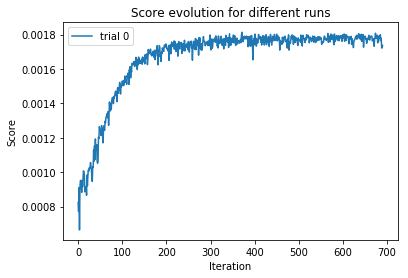

In [210]:
plt.figure();
for trial_idx, scores in enumerate(scores_all_trials):
    plt.plot(scores, label='trial ' + str(trial_idx));
plt.xlabel('Iteration');
plt.ylabel('Score');
plt.legend();
plt.title('Score evolution for different runs');

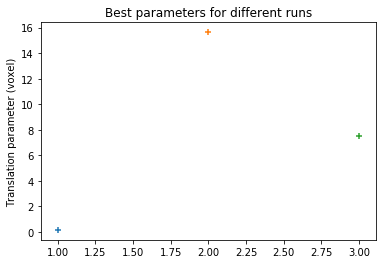

In [211]:
T_all_trials = np.array(T_all_trials)
plt.scatter(np.ones((T_all_trials.shape[0],)), T_all_trials[:, 3], marker='+');
plt.scatter(2*np.ones((T_all_trials.shape[0],)), T_all_trials[:, 7], marker='+');
plt.scatter(3*np.ones((T_all_trials.shape[0],)), T_all_trials[:, 11], marker='+');
plt.ylabel('Translation parameter (voxel)');
plt.title('Best parameters for different runs');

Best trial: 0
[[  9.26423404e-01   7.55088843e-03  -3.76407572e-01   1.68390978e-01]
 [  5.15966912e-02   9.87818540e-01   1.46807062e-01   1.56367440e+01]
 [  3.72930902e-01  -1.55426884e-01   9.14748614e-01   7.48656202e+00]]


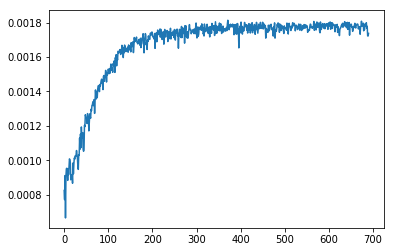

0.00181319987277 0.00173655160451


In [212]:
best_trial = np.argsort([np.max(scores) for scores in scores_all_trials])[-1]
# best_trial = 0
T = T_all_trials[best_trial]
scores = scores_all_trials[best_trial]
print 'Best trial:', best_trial
print T.reshape((3,4))
plt.figure();
plt.plot(scores);
plt.show();
print max(scores), scores[-1]

# Draw Results

In [213]:
t = time.time()

# local_params, centroid_m, centroid_f, xdim_m, ydim_m, zdim_m, xdim_f, ydim_f, zdim_f = \
# DataManager.load_alignment_parameters(stack_m=stack_moving, stack_f=stack_fixed,
#                                       classifier_setting_m=classifier_setting,
#                                       classifier_setting_f=classifier_setting,
#                                       warp_setting=warp_setting,
#                                       param_suffix=structure,
#                                       trial_idx=trial_idx)

local_params, centroid_m, centroid_f, xdim_m, ydim_m, zdim_m, xdim_f, ydim_f, zdim_f = \
(T, 
  aligner.centroid_m, aligner.centroid_f,
  aligner.xdim_m, aligner.ydim_m, aligner.zdim_m, 
  aligner.xdim_f, aligner.ydim_f, aligner.zdim_f)

# local_params, centroid_m, centroid_f, xdim_m, ydim_m, zdim_m, xdim_f, ydim_f, zdim_f = \
# ([1,0,0,0,0,1,0,0,0,0,1,0], 
#   aligner.centroid_m, aligner.centroid_f,
#   aligner.xdim_m, aligner.ydim_m, aligner.zdim_m, 
#   aligner.xdim_f, aligner.ydim_f, aligner.zdim_f)


# Read global tx
global_transformed_moving_structure_vol = \
DataManager.load_transformed_volume(stack_m=stack_moving, stack_f=stack_fixed,
                                    detector_id_f=detector_id,
                                    warp_setting=upstream_warp_setting, 
                                    structure=structure)

# Transform
local_transformed_moving_structure_vol = transform_volume(vol=global_transformed_moving_structure_vol, 
                                         global_params=local_params, 
                                         centroid_m=centroid_m, centroid_f=centroid_f,
                                         xdim_f=xdim_f, ydim_f=ydim_f, zdim_f=zdim_f)

#         # Save
#         local_transformed_moving_structure_fn = \
#         DataManager.get_transformed_volume_filepath(stack_m=stack_moving, stack_f=stack_fixed,
#                                                     classifier_setting_m=classifier_setting,
#                                                     classifier_setting_f=classifier_setting,
#                                                     warp_setting=warp_setting,
#                                                     trial_idx=trial_idx,
#                                                     structure=structure)

#         create_if_not_exists(os.path.dirname(local_transformed_moving_structure_fn))
#         bp.pack_ndarray_file(local_transformed_moving_structure_vol, local_transformed_moving_structure_fn)

sys.stderr.write('Transform: %.2f seconds.\n' % (time.time() - t))

Transform: 5.24 seconds.


In [214]:
# Set colors for different contour level
levels = [0.1, 0.25, 0.5, 0.75, .99]
# levels = [0.5]
level_colors = {level: (int(level*255),0,0) for level in levels}

0 796 0 432 134 506
rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F35-2017.06.05-17.08.18_MD662_3_0105_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F35-2017.06.05-17.08.18_MD662_3_0105_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F35-2017.06.05-17.08.18_MD662_3_0105_prep2_down8_VCA_detector1_scoremapViz.jpg"
rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F36-2017.06.05-17.38.33_MD662_1_0106_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F36-2017.06.05-17.38.33_MD662_1_0106_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scorema

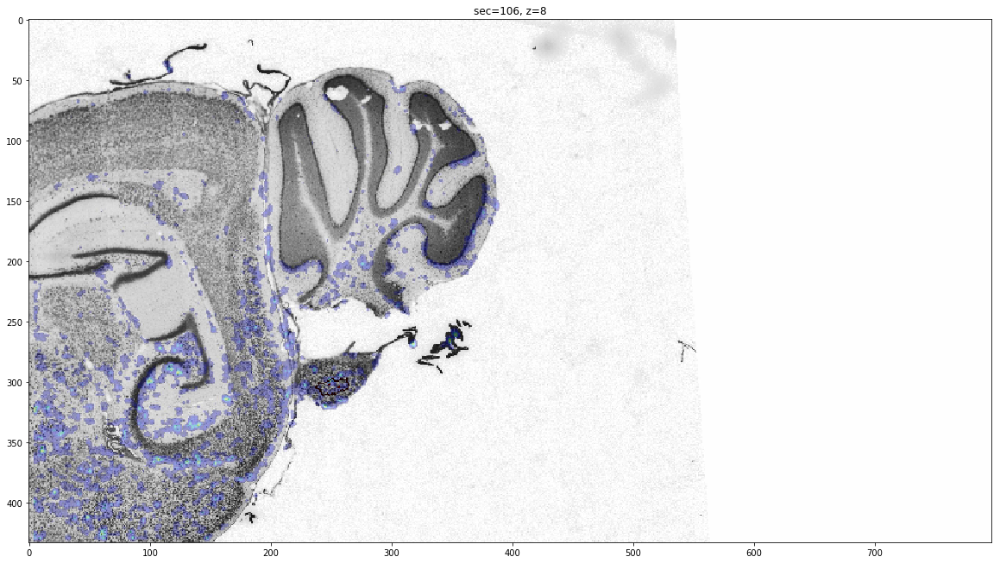

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F37-2017.06.05-18.09.08_MD662_2_0110_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F37-2017.06.05-18.09.08_MD662_2_0110_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F37-2017.06.05-18.09.08_MD662_2_0110_prep2_down8_VCA_detector1_scoremapViz.jpg"


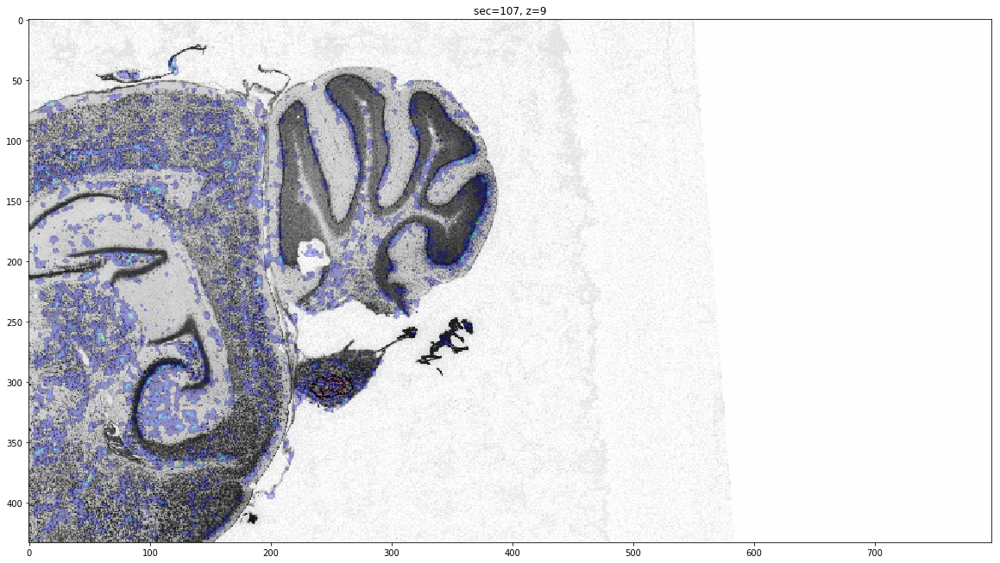

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F37-2017.06.05-18.09.08_MD662_3_0111_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F37-2017.06.05-18.09.08_MD662_3_0111_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F37-2017.06.05-18.09.08_MD662_3_0111_prep2_down8_VCA_detector1_scoremapViz.jpg"


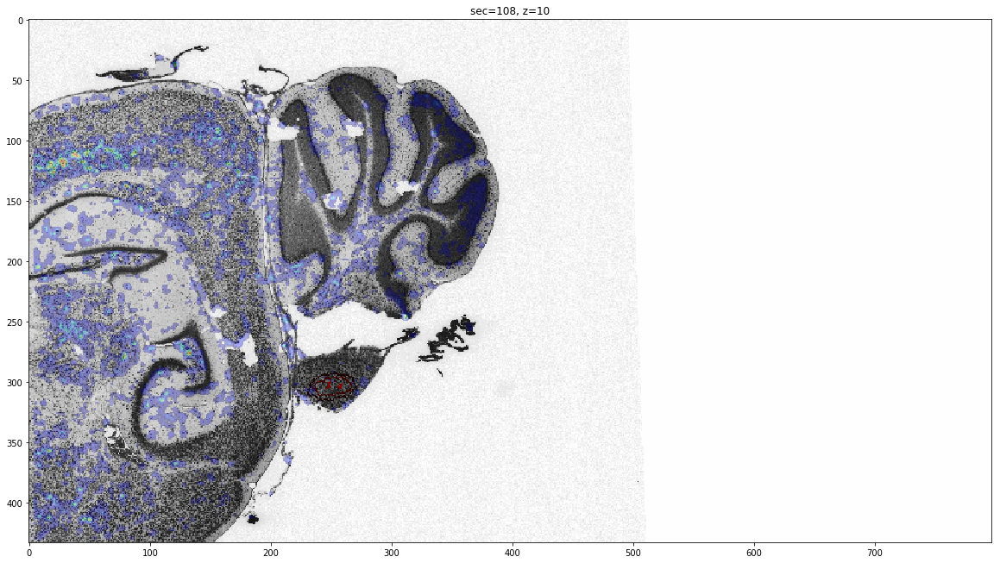

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_1_0112_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_1_0112_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_1_0112_prep2_down8_VCA_detector1_scoremapViz.jpg"


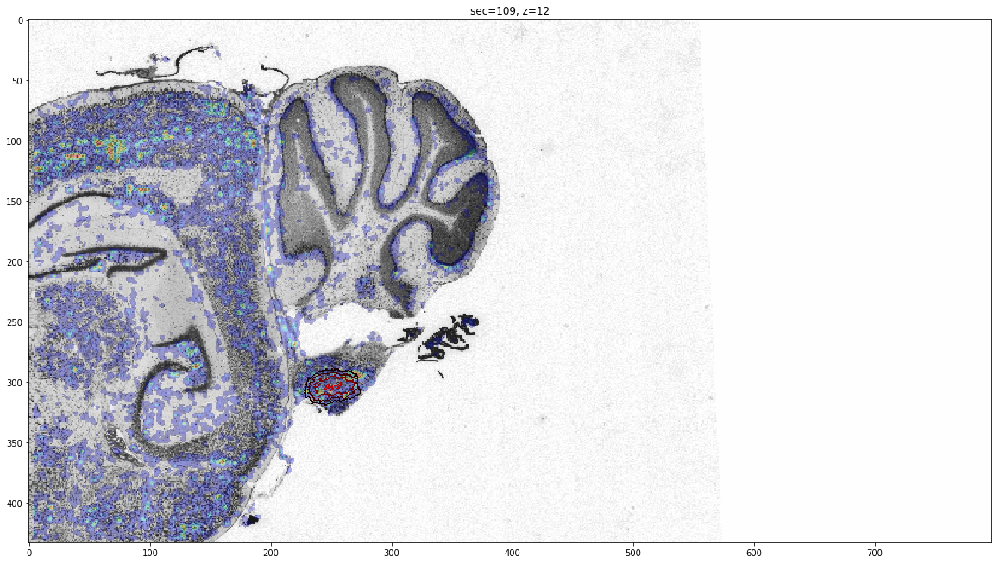

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_2_0113_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_2_0113_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_2_0113_prep2_down8_VCA_detector1_scoremapViz.jpg"


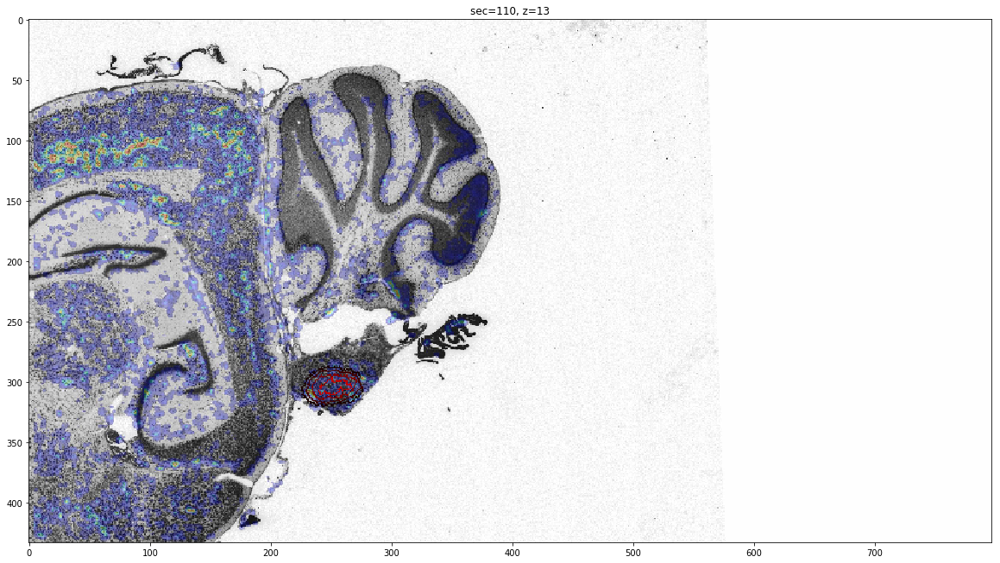

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_3_0114_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_3_0114_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F38-2017.06.05-18.38.44_MD662_3_0114_prep2_down8_VCA_detector1_scoremapViz.jpg"


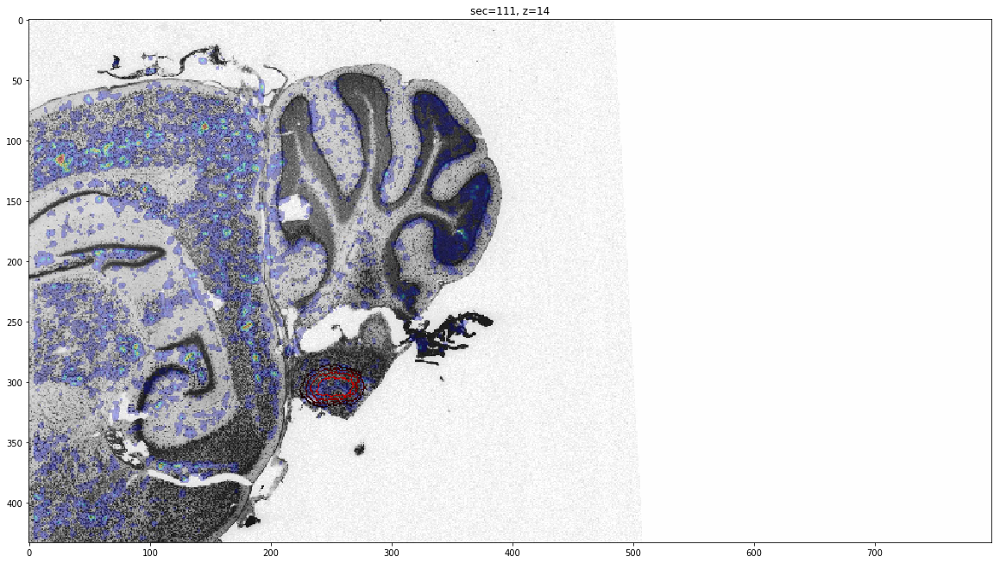

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_1_0115_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_1_0115_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_1_0115_prep2_down8_VCA_detector1_scoremapViz.jpg"


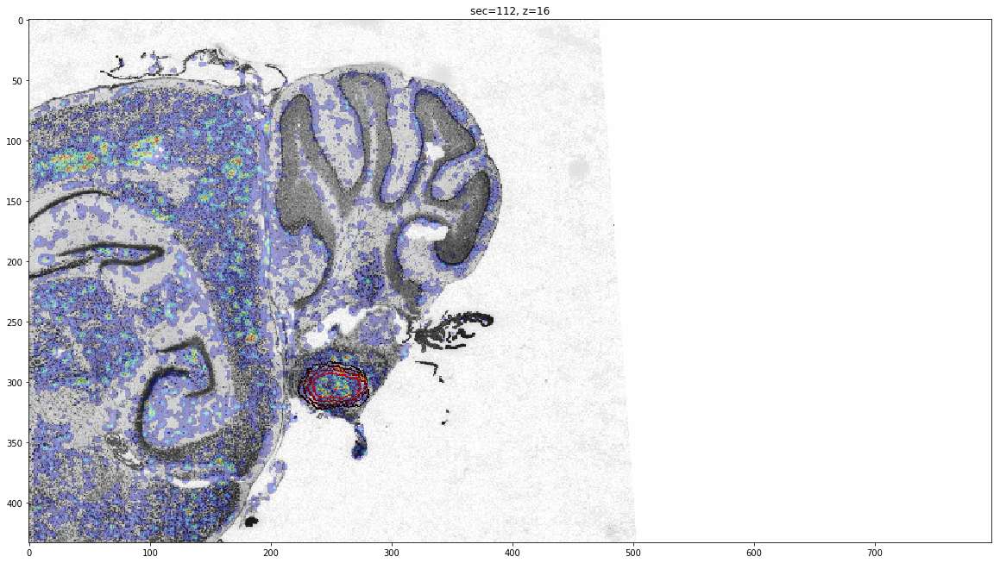

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_2_0116_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_2_0116_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_2_0116_prep2_down8_VCA_detector1_scoremapViz.jpg"


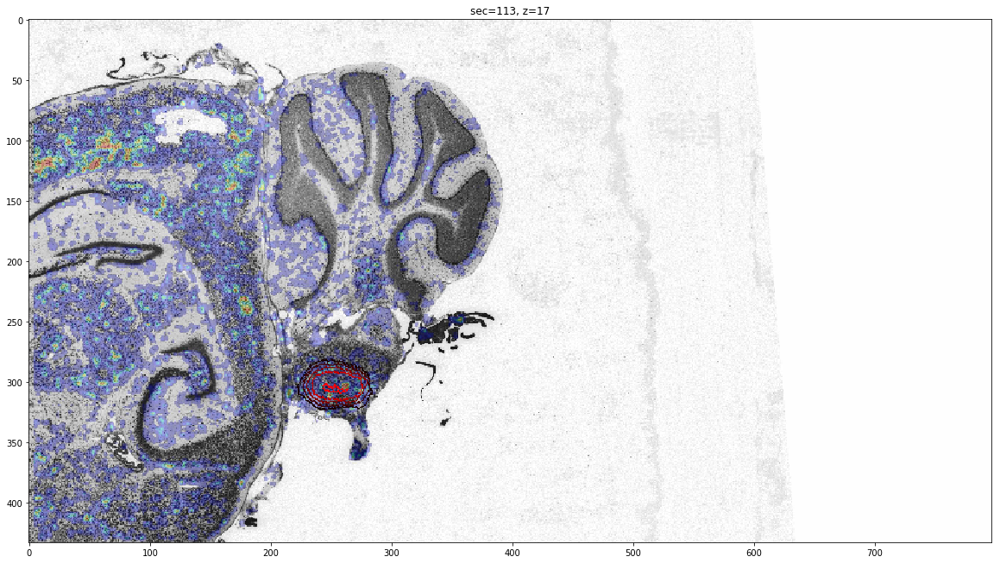

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_3_0117_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_3_0117_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F39-2017.06.05-19.07.49_MD662_3_0117_prep2_down8_VCA_detector1_scoremapViz.jpg"


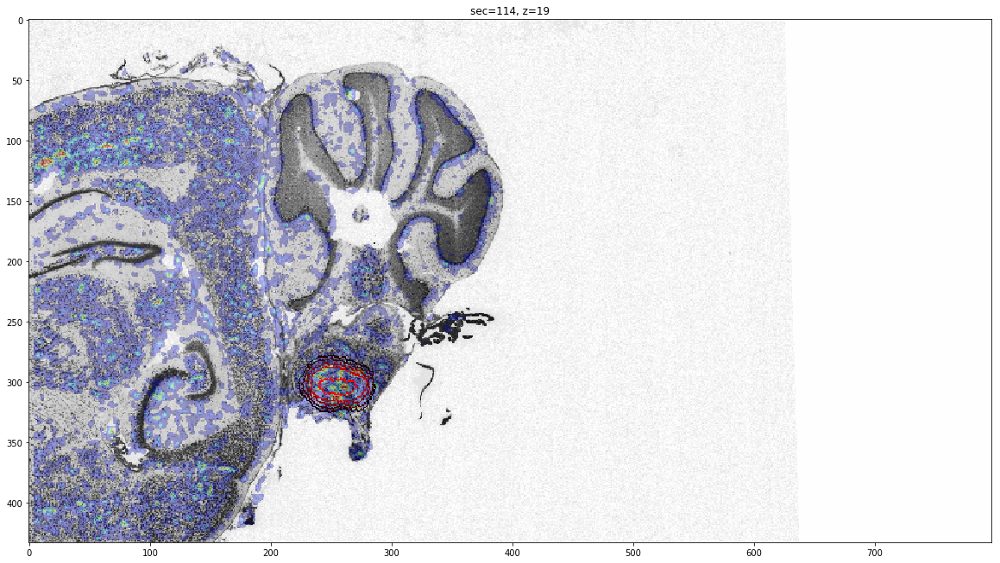

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_1_0118_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_1_0118_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_1_0118_prep2_down8_VCA_detector1_scoremapViz.jpg"


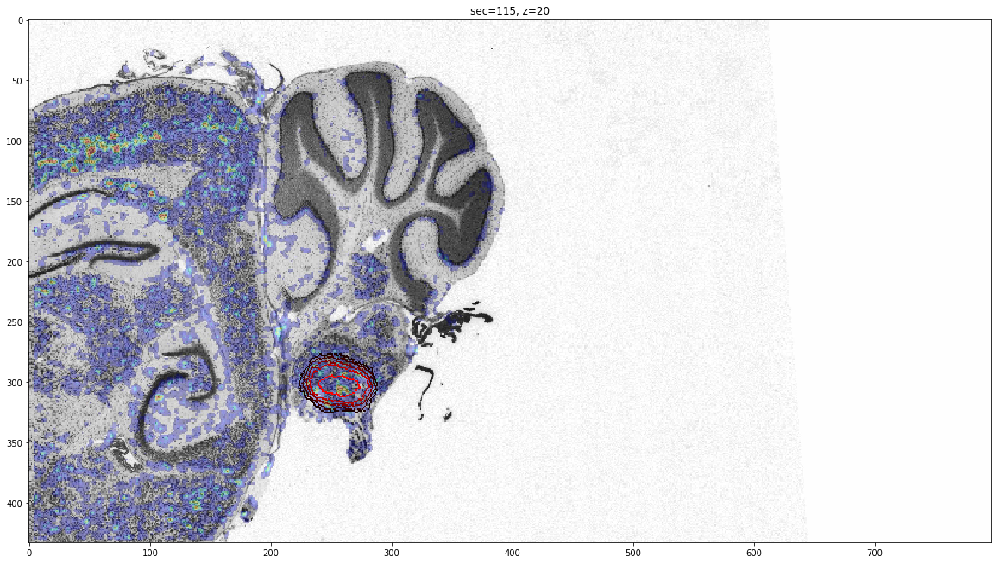

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_2_0119_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_2_0119_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_2_0119_prep2_down8_VCA_detector1_scoremapViz.jpg"


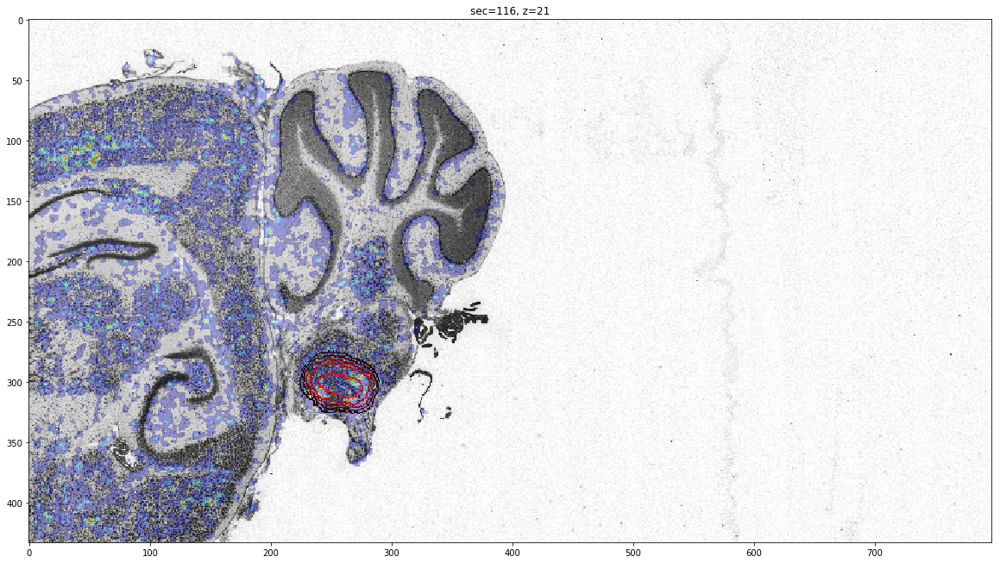

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_3_0120_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_3_0120_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F40-2017.06.05-19.36.43_MD662_3_0120_prep2_down8_VCA_detector1_scoremapViz.jpg"


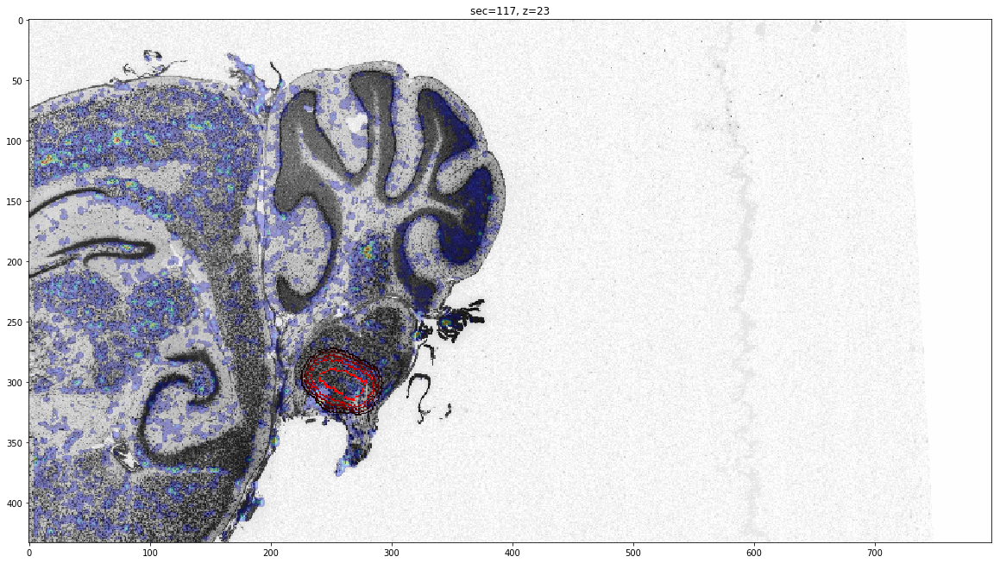

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_1_0121_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_1_0121_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_1_0121_prep2_down8_VCA_detector1_scoremapViz.jpg"


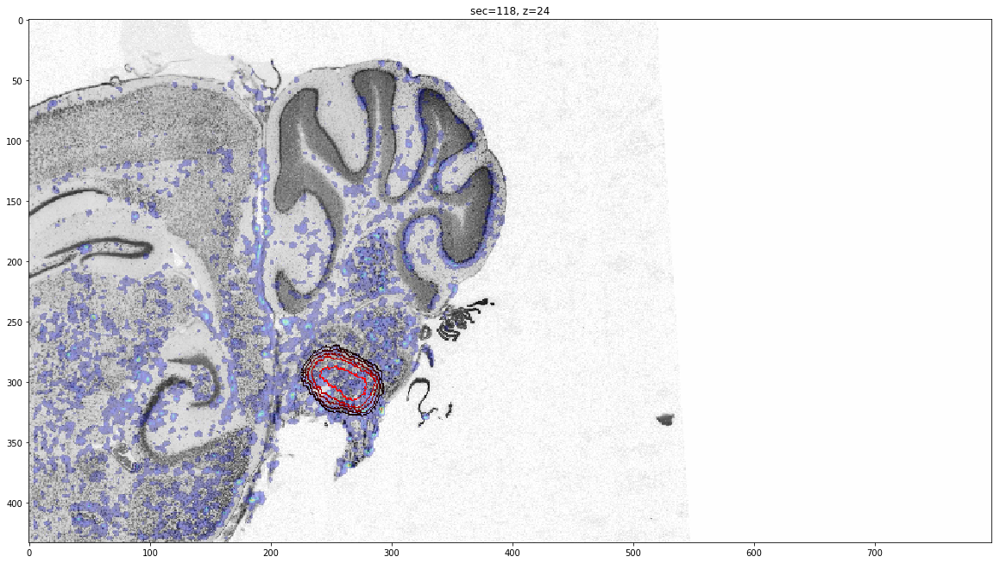

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_2_0122_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_2_0122_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_2_0122_prep2_down8_VCA_detector1_scoremapViz.jpg"


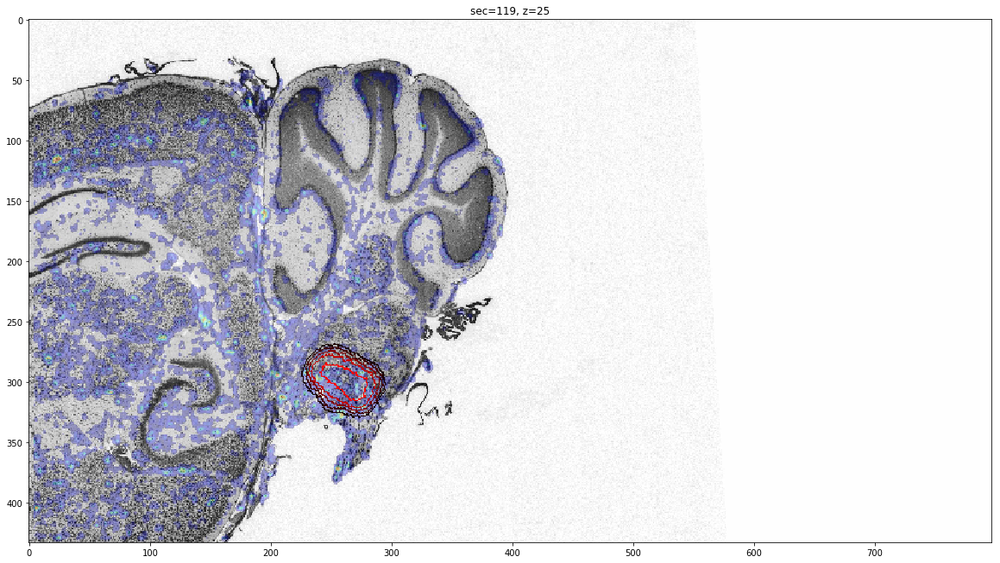

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_3_0123_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_3_0123_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F41-2017.06.05-20.06.59_MD662_3_0123_prep2_down8_VCA_detector1_scoremapViz.jpg"


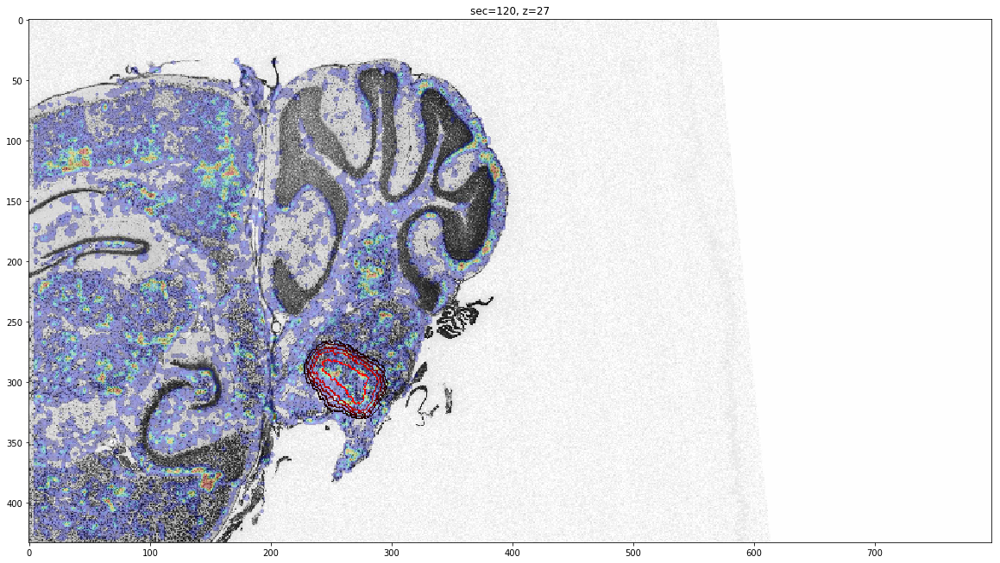

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_1_0124_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_1_0124_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_1_0124_prep2_down8_VCA_detector1_scoremapViz.jpg"


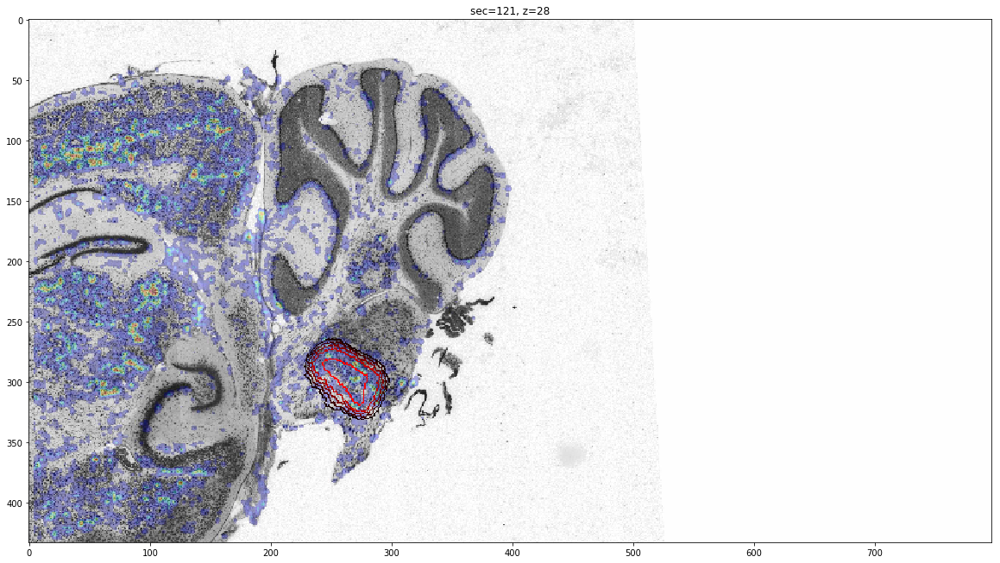

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_2_0125_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_2_0125_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_2_0125_prep2_down8_VCA_detector1_scoremapViz.jpg"


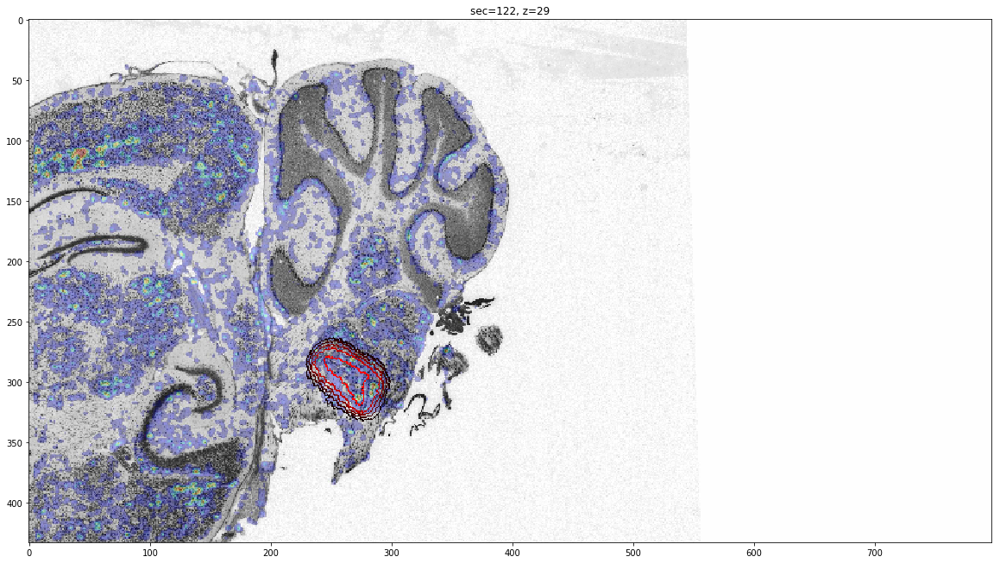

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_3_0126_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_3_0126_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F42-2017.06.05-20.35.31_MD662_3_0126_prep2_down8_VCA_detector1_scoremapViz.jpg"


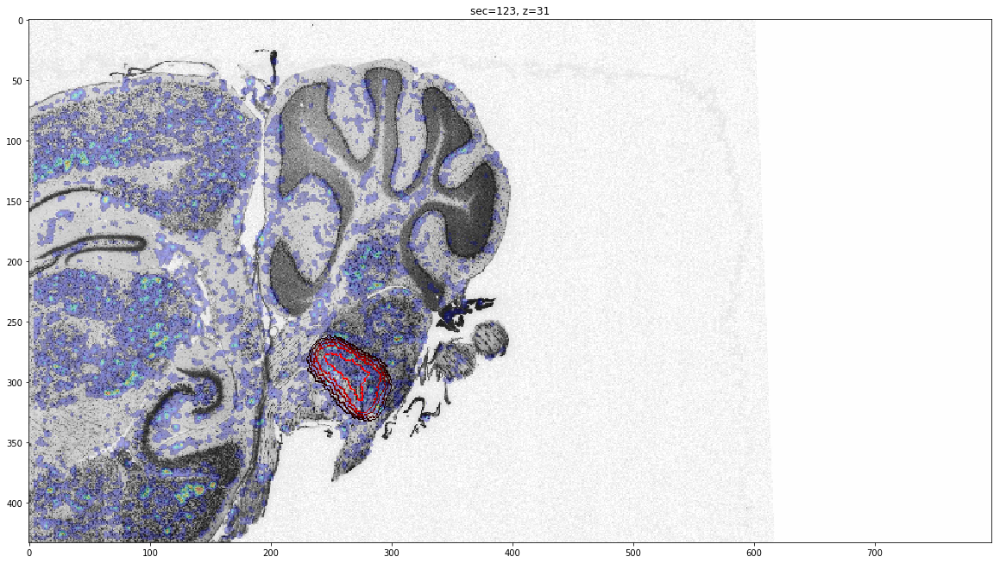

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_1_0127_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_1_0127_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_1_0127_prep2_down8_VCA_detector1_scoremapViz.jpg"


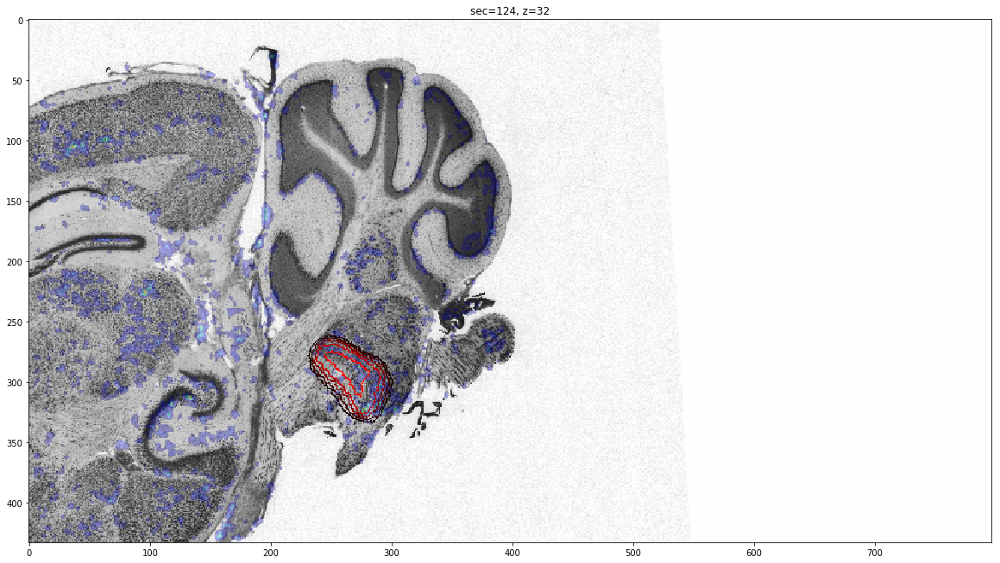

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_2_0128_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_2_0128_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_2_0128_prep2_down8_VCA_detector1_scoremapViz.jpg"


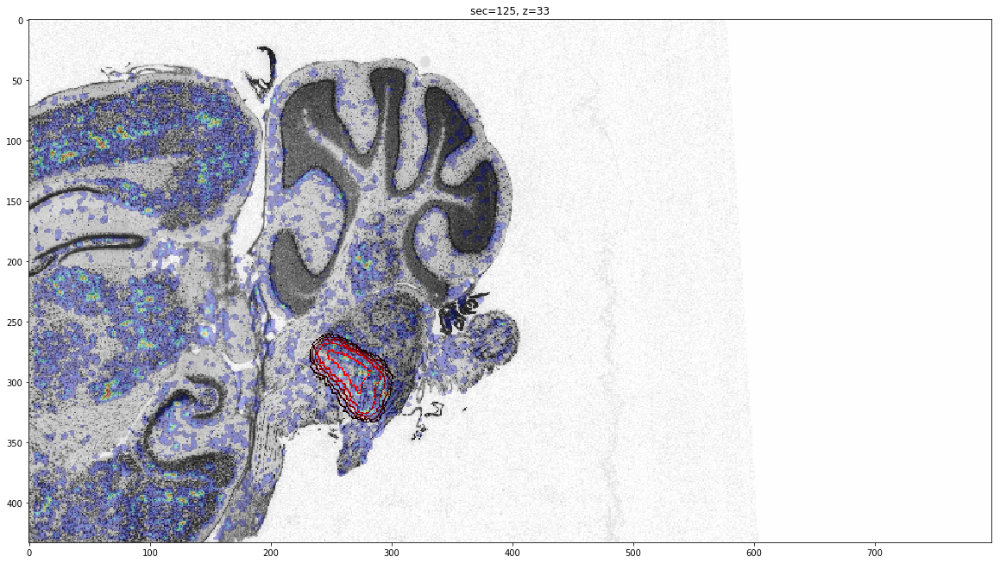

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_3_0129_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_3_0129_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F43-2017.06.05-21.05.21_MD662_3_0129_prep2_down8_VCA_detector1_scoremapViz.jpg"


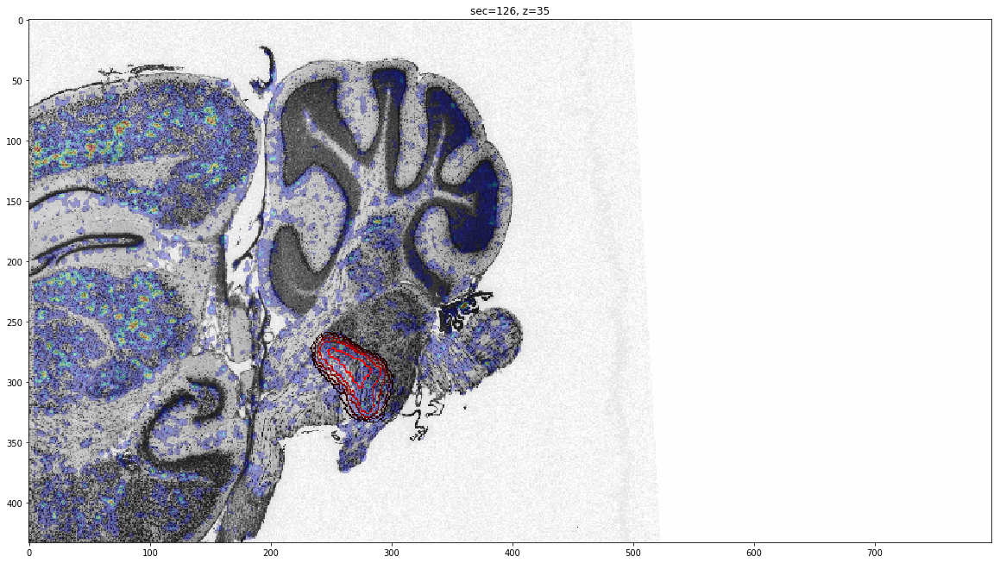

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_1_0130_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_1_0130_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_1_0130_prep2_down8_VCA_detector1_scoremapViz.jpg"


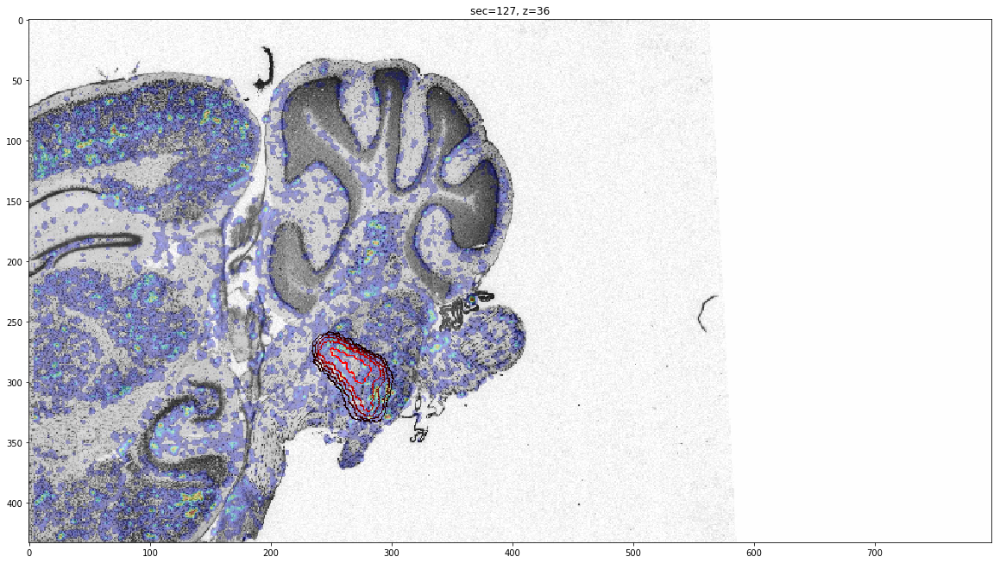

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_2_0131_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_2_0131_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_2_0131_prep2_down8_VCA_detector1_scoremapViz.jpg"


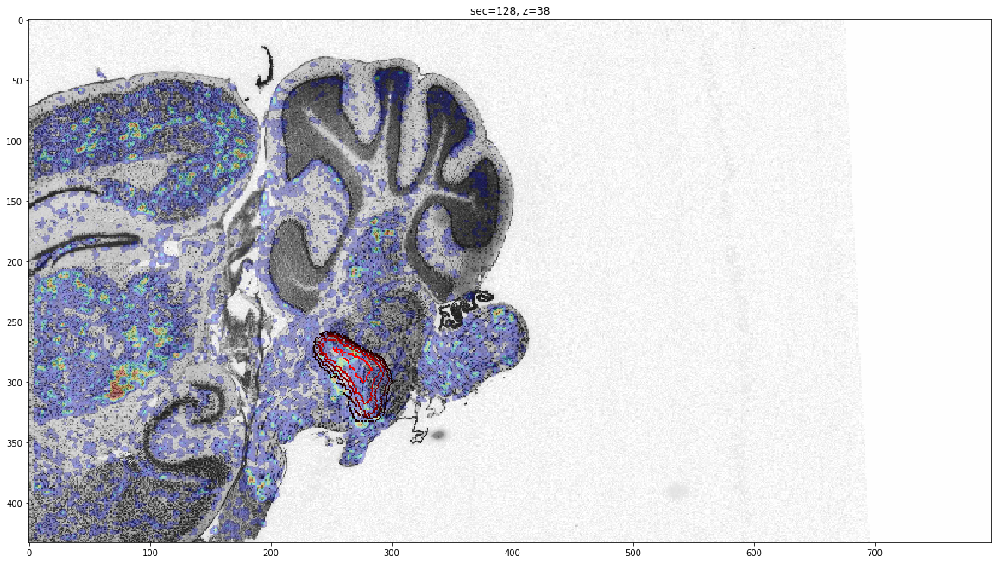

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_3_0132_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_3_0132_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F44-2017.06.05-21.36.28_MD662_3_0132_prep2_down8_VCA_detector1_scoremapViz.jpg"


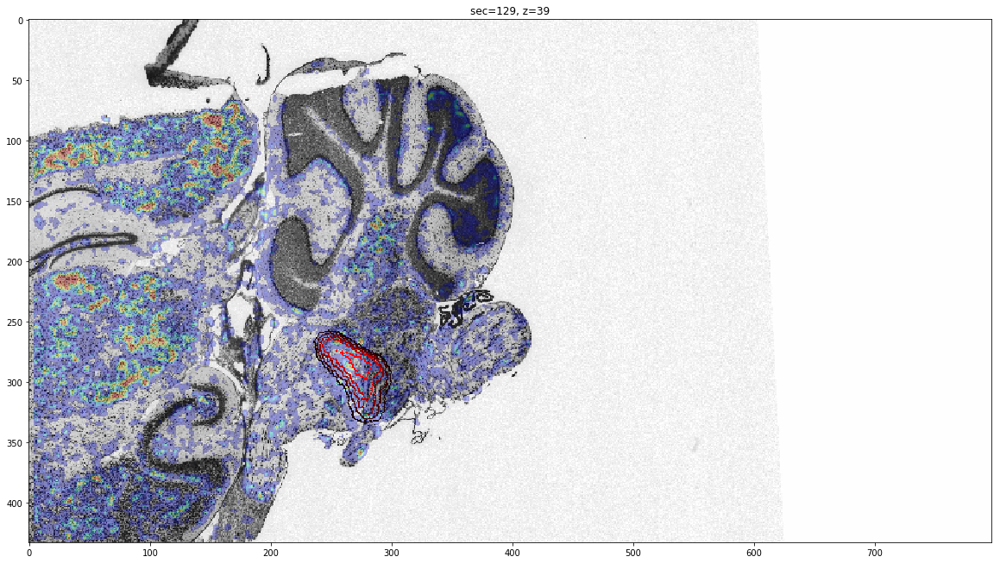

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_1_0133_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_1_0133_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_1_0133_prep2_down8_VCA_detector1_scoremapViz.jpg"


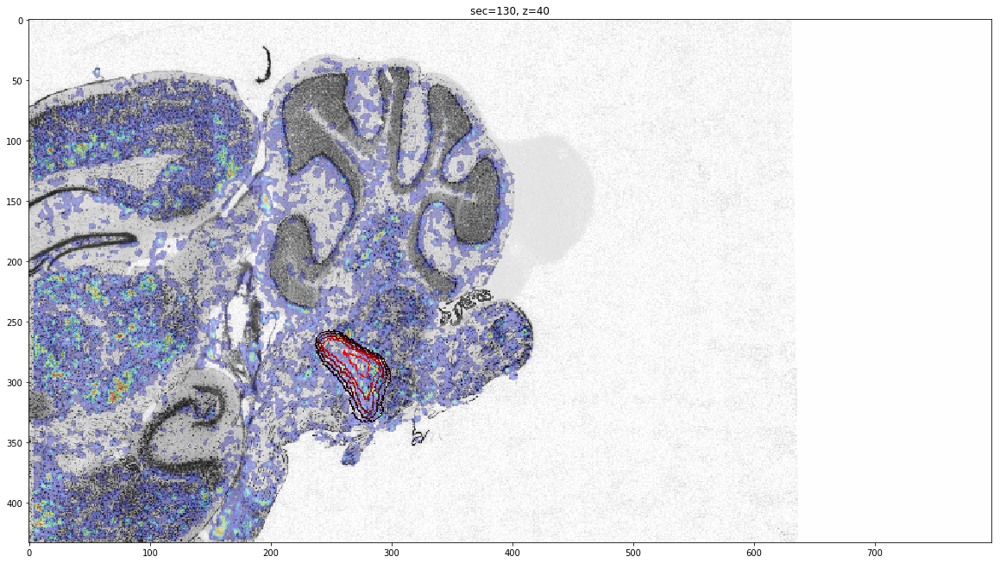

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_2_0134_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_2_0134_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_2_0134_prep2_down8_VCA_detector1_scoremapViz.jpg"


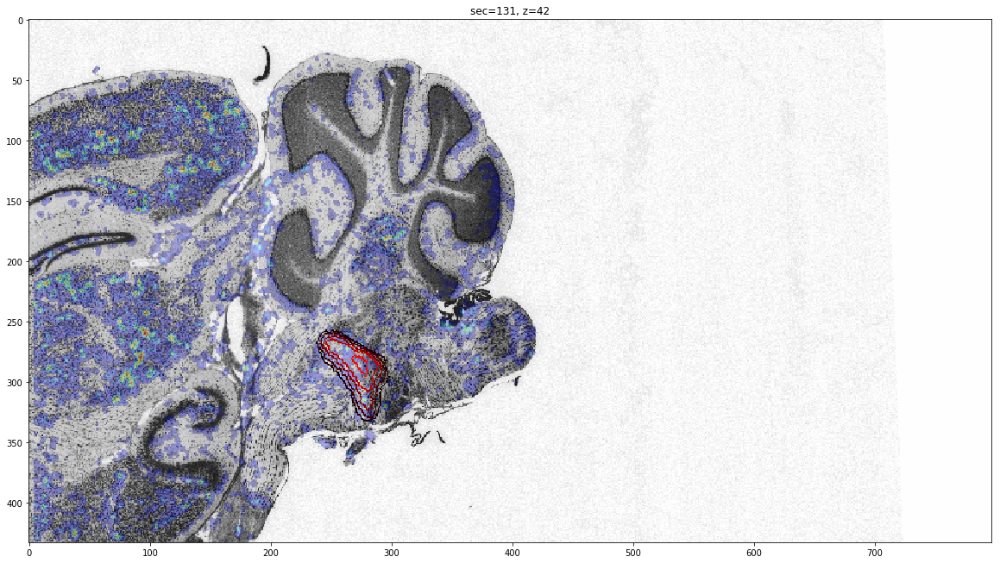

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_3_0135_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_3_0135_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F45-2017.06.05-22.05.50_MD662_3_0135_prep2_down8_VCA_detector1_scoremapViz.jpg"


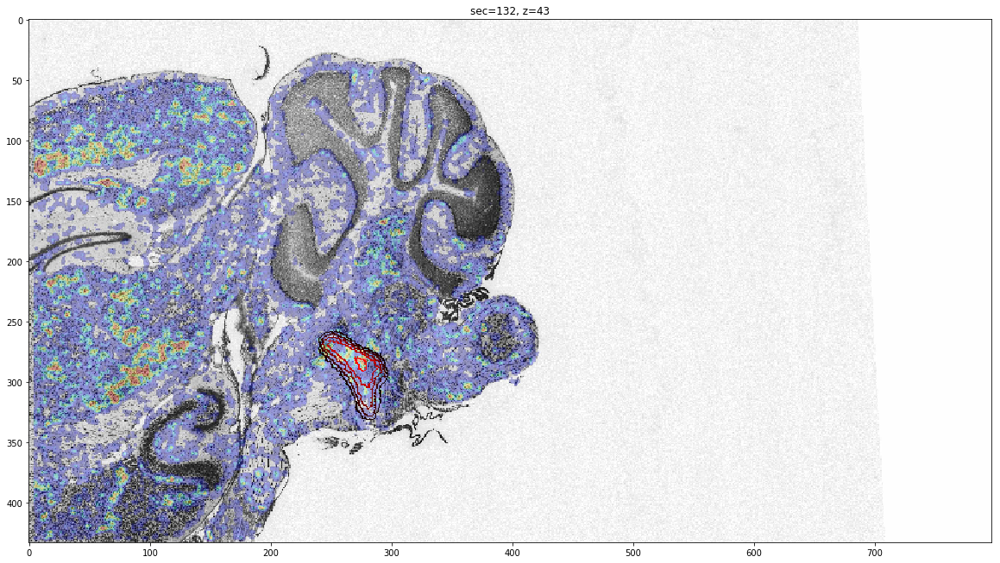

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_1_0136_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_1_0136_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_1_0136_prep2_down8_VCA_detector1_scoremapViz.jpg"


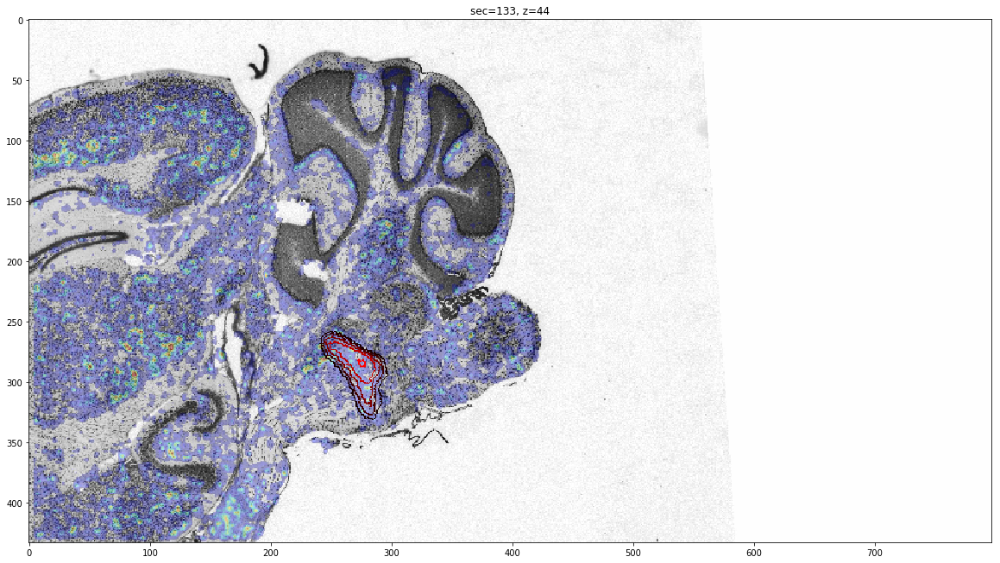

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_2_0137_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_2_0137_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_2_0137_prep2_down8_VCA_detector1_scoremapViz.jpg"
rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_3_0138_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F46-2017.06.05-22.36.28_MD662_3_0138_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD66

Error loading scoremap for section 134


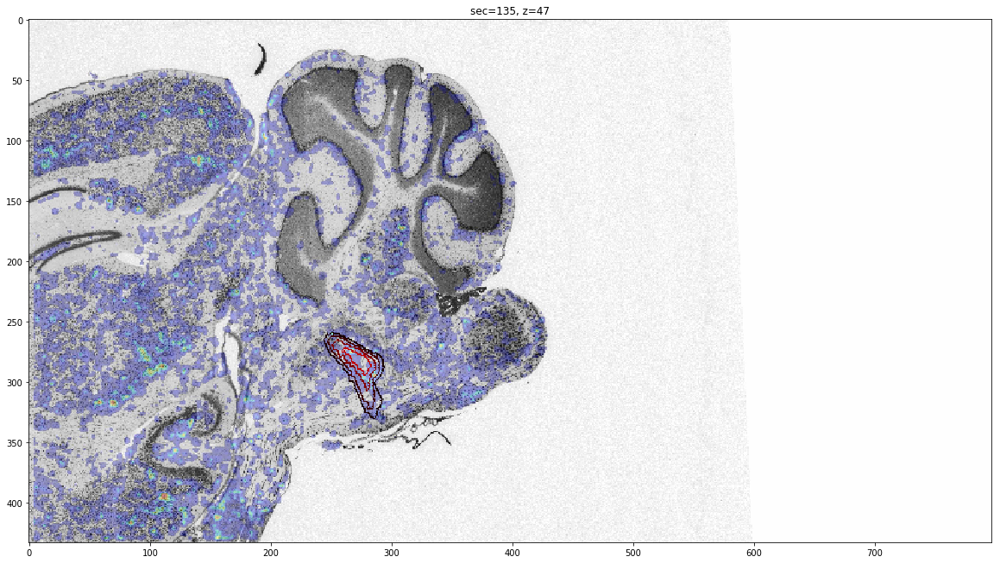

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_1_0139_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_1_0139_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_1_0139_prep2_down8_VCA_detector1_scoremapViz.jpg"


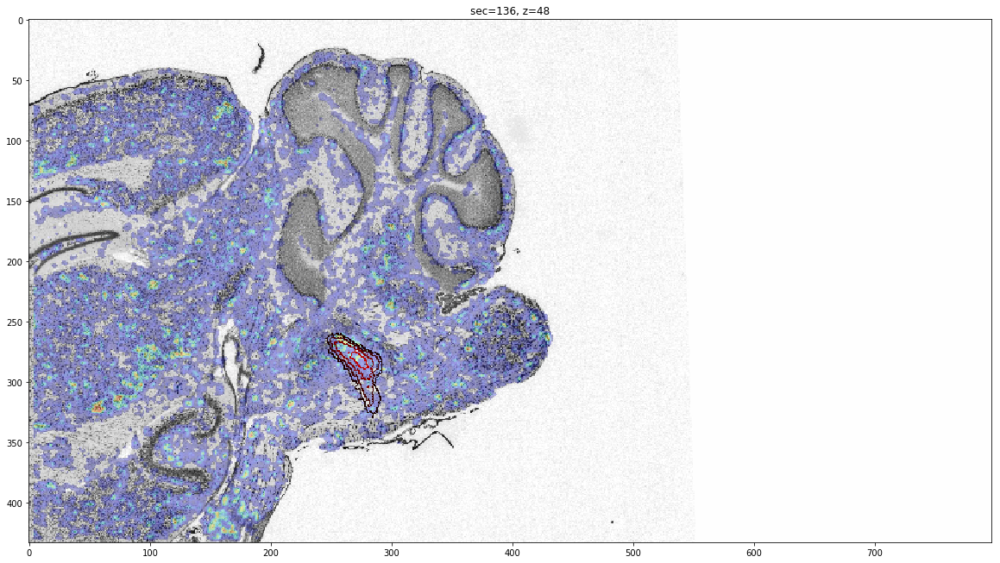

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_2_0140_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_2_0140_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_2_0140_prep2_down8_VCA_detector1_scoremapViz.jpg"


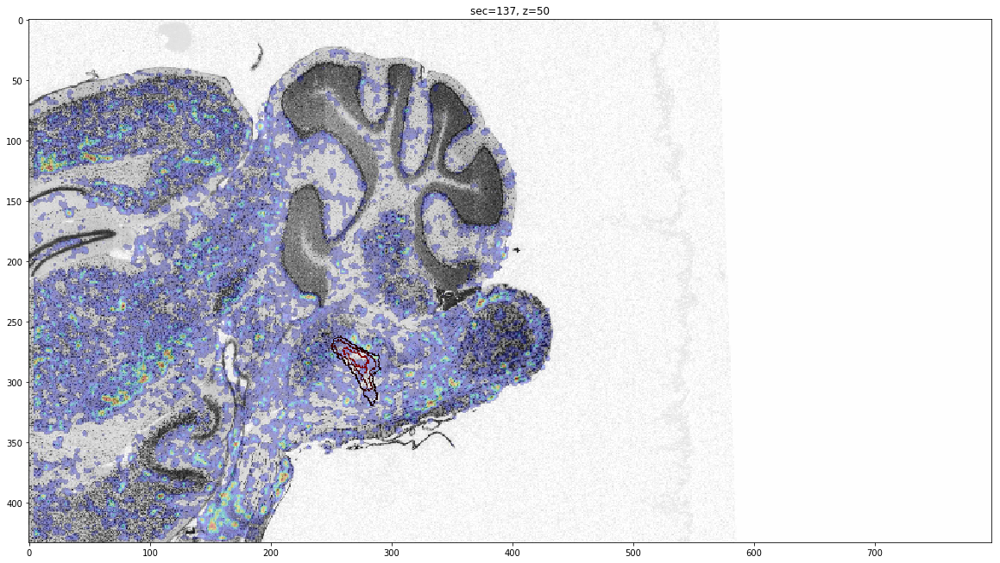

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_3_0141_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_3_0141_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F47-2017.06.05-23.06.43_MD662_3_0141_prep2_down8_VCA_detector1_scoremapViz.jpg"


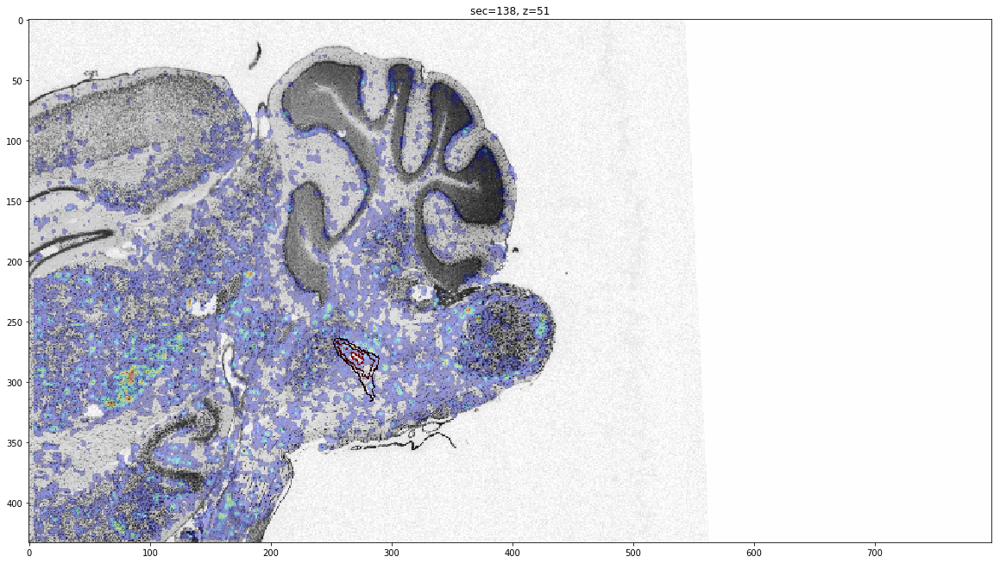

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_1_0142_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_1_0142_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_1_0142_prep2_down8_VCA_detector1_scoremapViz.jpg"


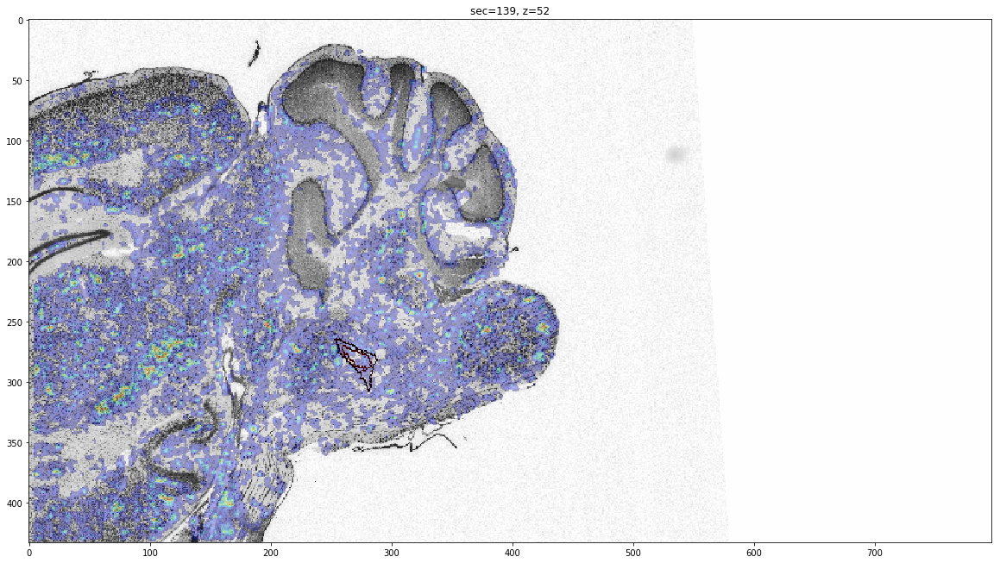

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_2_0143_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_2_0143_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_2_0143_prep2_down8_VCA_detector1_scoremapViz.jpg"


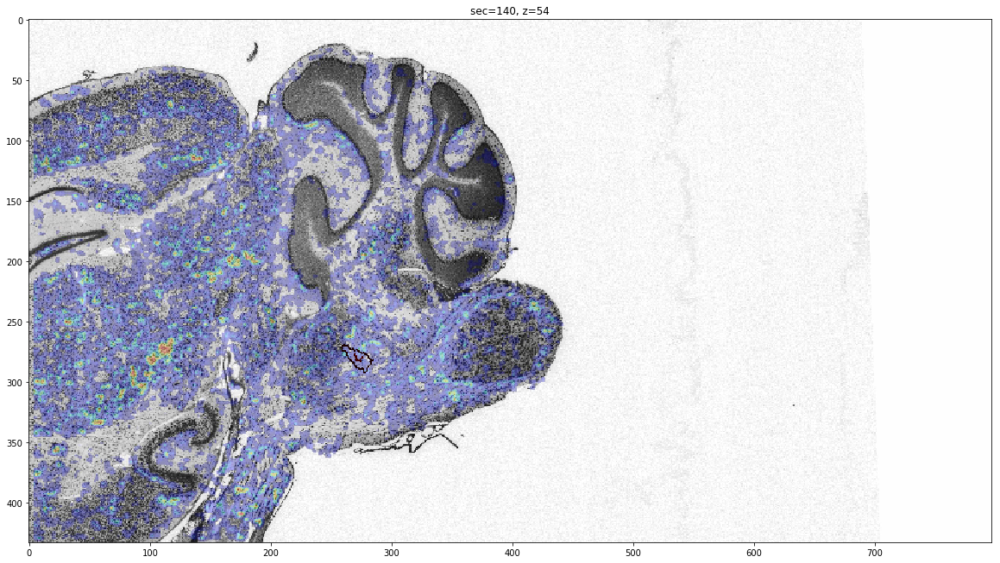

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_3_0144_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_3_0144_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F48-2017.06.05-23.36.49_MD662_3_0144_prep2_down8_VCA_detector1_scoremapViz.jpg"


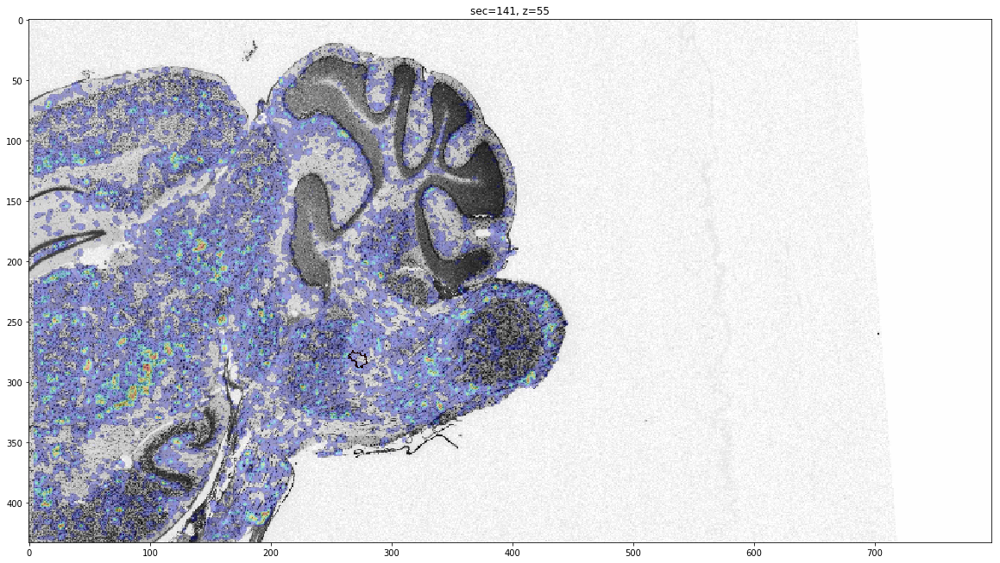

rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F49-2017.06.06-00.05.38_MD662_1_0145_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F49-2017.06.06-00.05.38_MD662_1_0145_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F49-2017.06.06-00.05.38_MD662_1_0145_prep2_down8_VCA_detector1_scoremapViz.jpg"
rm -rf "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F49-2017.06.06-00.05.38_MD662_2_0146_prep2_down8_VCA_detector1_scoremapViz.jpg" && mkdir -p "/shared/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2"
aws s3 cp "s3://mousebrainatlas-data/CSHL_scoremap_viz/down8/VCA/MD662/detector1/prep2/MD662&661-F49-2017.06.06-00.05.38_MD662_2_0146_prep2_down8_VCA_detector1_scoremapViz.jpg" "/shared/CSHL_scoremap_viz/down8/VCA/MD66

In [215]:
# Generate overlay visualization

# estimate mapping between z and section
# downsample_factor = 32
# xy_pixel_distance_downsampled = XY_PIXEL_DISTANCE_LOSSLESS * downsample_factor
# voxel_z_size = SECTION_THICKNESS / xy_pixel_distance_downsampled

# For getting correct contour location
xmin_vol_f, xmax_vol_f, ymin_vol_f, ymax_vol_f, zmin_vol_f, zmax_vol_f = \
DataManager.load_original_volume_bbox(stack=stack_fixed, volume_type='score', prep_id=2,
                                      structure='7N', downscale=32, detector_id=detector_id)
print xmin_vol_f, xmax_vol_f, ymin_vol_f, ymax_vol_f, zmin_vol_f, zmax_vol_f

# Generate atlas overlay image for every section

zf, zl = bbox_3d(local_transformed_moving_structure_vol)[4:]
sec_first = DataManager.convert_z_to_section(stack=stack_fixed, z=zf, downsample=32)
sec_last = DataManager.convert_z_to_section(stack=stack_fixed, z=zl, downsample=32)

for sec in range(sec_first, sec_last+1):
# for sec in [181]:
    
    if is_invalid(stack=stack_fixed, sec=sec):
        continue
    
#     img_fn = DataManager.get_image_filepath(stack=stack_fixed, section=sec, resol='thumbnail', version='cropped_tif')
#     img = imread(img_fn)
    
    try:
#         img = DataManager.load_image(stack=stack_fixed, section=sec, resol='thumbnail', version='cropped_tif')
        sc_viz_fp = DataManager.get_scoremap_viz_filepath(stack=stack_fixed, section=sec, 
                                                           downscale=8,
                                                           structure=convert_to_original_name(structure), 
                                                           detector_id=detector_id, prep_id=2)
        download_from_s3(sc_viz_fp)
        img = imread(sc_viz_fp)[::4, ::4]
    except:
        sys.stderr.write('Error loading scoremap for section %d\n' % sec)
        continue
        
#     img = img[::4, ::4]
    
    viz = img.copy()
    
    z1, z2 = DataManager.convert_section_to_z(stack=stack_fixed, sec=sec, downsample=32)
    z = int(z1)
    
    # Find moving volume annotation contours
    c = 0
    vol = local_transformed_moving_structure_vol
    for level in levels:
        cnts = find_contours(vol[..., z], level=level) # rows, cols
        c += len(cnts)
        for cnt in cnts:
            # r,c to x,y
            cnt_on_cropped = cnt[:,::-1] + (xmin_vol_f, ymin_vol_f)
            cv2.polylines(viz, [cnt_on_cropped.astype(np.int)], True, level_colors[level], 1)
    
    if c > 0:    
        plt.figure(figsize=(20, 20));
        plt.title("sec=%d, z=%d" % (sec, z));
        plt.imshow(viz);
        plt.show();
    
#     viz_fp = DataManager.get_alignment_viz_filepath(stack_m=stack_moving,
#                                             stack_f=stack_fixed,
#                                             classifier_setting_m=classifier_setting,
#                                             classifier_setting_f=classifier_setting,
#                                             warp_setting=warp_setting,
#                                           section=sec)
    
#     create_if_not_exists(os.path.dirname(viz_fp))
#     imsave(viz_fp, viz)

In [191]:
display_image(viz)

/shared/MouseBrainAtlas/registration/tmp.jpg